# Initial Code

In [ ]:
import os
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from xgboost import XGBClassifier
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error,r2_score
from sklearn.metrics import accuracy_score
from sklearn.tree import DecisionTreeClassifier

In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/movie-recommendation-system/movies.csv
/kaggle/input/movie-recommendation-system/ratings.csv
/kaggle/input/movie-recommendation-system/movierecommendation.py
/kaggle/input/movie-recommendation-system/tags.csv
/kaggle/input/movie-recommendation-system/links.csv


In [ ]:
df_movies=pd.read_csv('/kaggle/input/movie-recommendation-system/movies.csv', encoding='ISO-8859-1')
df_movies
df_movies2=df_movies

In [ ]:
df_movie_Id=df_movies.iloc[:,:2];
df_movie_Id

,movieId,title
0,1,Toy Story (1995)
1,2,Jumanji (1995)
2,3,Grumpier Old Men (1995)
3,4,Waiting to Exhale (1995)
4,5,Father of the Bride Part II (1995)
...,...,...
34203,151697,Grand Slam (1967)
34204,151701,Bloodmoney (2010)
34205,151703,The Butterfly Circus (2009)
34206,151709,Zero (2015)


In [ ]:
df_ratings=pd.read_csv('/kaggle/input/movie-recommendation-system/ratings.csv', encoding='ISO-8859-1')
df_ratings
df_ratings2=df_ratings

In [ ]:
df_links=pd.read_csv('/kaggle/input/movie-recommendation-system/links.csv', encoding='ISO-8859-1')
df_links

,movieId,imdbId,tmdbId
0,1,114709,862.0
1,2,113497,8844.0
2,3,113228,15602.0
3,4,114885,31357.0
4,5,113041,11862.0
...,...,...,...
34203,151697,62636,76851.0
34204,151701,1773315,235450.0
34205,151703,1507355,58500.0
34206,151709,2436672,365065.0


In [ ]:
df_tags=pd.read_csv('/kaggle/input/movie-recommendation-system/tags.csv', encoding='ISO-8859-1')
df_tags

,userId,movieId,tag,timestamp
0,19,2324,bittersweet,1428651158
1,19,2324,holocaust,1428651112
2,19,2324,World War II,1428651118
3,23,7075,hilarious,1378675786
4,23,7075,Underrated,1378675786
...,...,...,...,...
586989,247751,96655,future,1366041126
586990,247751,96655,robots,1366041128
586991,247753,356,classic,1430438776
586992,247753,356,oscar (best supporting actor),1430438776


# **Analysis of tags dataset**

In [ ]:
df_tags.nunique()

userId        15357
movieId       21654
tag           45084
timestamp    540785
dtype: int64

In [ ]:
df_tags['Datetime'] = pd.to_datetime(df_tags['timestamp'],unit='s')
df_tags

,userId,movieId,tag,timestamp,Datetime
0,19,2324,bittersweet,1428651158,2015-04-10 07:32:38
1,19,2324,holocaust,1428651112,2015-04-10 07:31:52
2,19,2324,World War II,1428651118,2015-04-10 07:31:58
3,23,7075,hilarious,1378675786,2013-09-08 21:29:46
4,23,7075,Underrated,1378675786,2013-09-08 21:29:46
...,...,...,...,...,...
586989,247751,96655,future,1366041126,2013-04-15 15:52:06
586990,247751,96655,robots,1366041128,2013-04-15 15:52:08
586991,247753,356,classic,1430438776,2015-05-01 00:06:16
586992,247753,356,oscar (best supporting actor),1430438776,2015-05-01 00:06:16


In [ ]:
df_tags['year'] = pd.DatetimeIndex(df_tags['Datetime']).year
df_tags['month'] = pd.DatetimeIndex(df_tags['Datetime']).month
df_tags.drop(['Datetime','timestamp'],axis=1,inplace=True)
df_tags

,userId,movieId,tag,year,month
0,19,2324,bittersweet,2015,4
1,19,2324,holocaust,2015,4
2,19,2324,World War II,2015,4
3,23,7075,hilarious,2013,9
4,23,7075,Underrated,2013,9
...,...,...,...,...,...
586989,247751,96655,future,2013,4
586990,247751,96655,robots,2013,4
586991,247753,356,classic,2015,5
586992,247753,356,oscar (best supporting actor),2015,5


In [ ]:
import plotly.express as px
fig = px.pie(df_tags, values='month', names='month', title='Monthly Distribution')
fig.show()
fig2 = px.pie(df_tags, values='year', names='year', title='Yearly Distribution')
fig2.show()
# fig3 = px.pie(df_tags, values='tag', names='tag', title='Distribution by tag')
# fig3.show()

In [ ]:
from sklearn.preprocessing import LabelEncoder
column_names=['tag','year'];
for col in column_names:
  le=LabelEncoder();
  values = le.fit_transform(df_tags[col]);
  df_tags[col]=values[:];
df_tags

,userId,movieId,tag,year,month
0,19,2324,23304,10,4
1,19,2324,30713,10,4
2,19,2324,20379,10,4
3,23,7075,30569,8,9
4,23,7075,19535,8,9
...,...,...,...,...,...
586989,247751,96655,29093,8,4
586990,247751,96655,38607,8,4
586991,247753,356,24867,10,5
586992,247753,356,36116,10,5


In [ ]:
print("NULL values in the dataset:\n",df_tags.isnull().sum());

NULL values in the dataset:
 userId     0
movieId    0
tag        0
year       0
month      0
dtype: int64


# **Analysis of ratings dataset**

In [ ]:
df_ratings

,userId,movieId,rating,timestamp
0,1,169,2.5,1204927694
1,1,2471,3.0,1204927438
2,1,48516,5.0,1204927435
3,2,2571,3.5,1436165433
4,2,109487,4.0,1436165496
...,...,...,...,...
22884372,247753,49530,5.0,1430437962
22884373,247753,69481,3.0,1430437984
22884374,247753,74458,4.0,1430437968
22884375,247753,76093,5.0,1430437811


In [ ]:
df_ratings.nunique()

userId         247753
movieId         33670
rating             10
timestamp    17764338
dtype: int64

In [ ]:
df_ratings.describe()

,userId,movieId,rating,timestamp
count,2.288438e+07,2.288438e+07,2.288438e+07,2.288438e+07
mean,1.235452e+05,1.140816e+04,3.526077e+00,1.128959e+09
std,7.147469e+04,2.413688e+04,1.061173e+00,1.819892e+08
min,1.000000e+00,1.000000e+00,5.000000e-01,7.896520e+08
25%,6.133900e+04,9.200000e+02,3.000000e+00,9.747639e+08
50%,1.233220e+05,2.329000e+03,3.500000e+00,1.115685e+09
75%,1.855250e+05,5.218000e+03,4.000000e+00,1.271194e+09
max,2.477530e+05,1.517110e+05,5.000000e+00,1.454054e+09


In [ ]:
df_ratings.isnull().sum()

userId       0
movieId      0
rating       0
timestamp    0
dtype: int64

In [ ]:
rating_unique_values = df_ratings["rating"].unique()
print('Different Unique values in ratings column:',rating_unique_values)

Different Unique values in ratings column: [2.5 3.  5.  3.5 4.  2.  1.  4.5 1.5 0.5]


In [ ]:
ratings_counts = []
for value in rating_unique_values:
    count = df_ratings["rating"].value_counts()[value]
    ratings_counts.append(count)
rating_mapping_dataframe=pd.DataFrame({'Rating value':rating_unique_values,'Total Count':ratings_counts})
rating_mapping_dataframe.T

,0,1,2,3,4,5,6,7,8,9
Rating value,2.5,3.0,5.0,3.5,4.0,2.0,1.0,4.5,1.5,0.5
Total Count,1044176.0,4783899.0,3358218.0,2592375.0,6265623.0,1603254.0,769654.0,1813922.0,337605.0,315651.0


In [ ]:
df_ratings['Datetime'] = pd.to_datetime(df_ratings['timestamp'],unit='s')
df_ratings

,userId,movieId,rating,timestamp,Datetime
0,1,169,2.5,1204927694,2008-03-07 22:08:14
1,1,2471,3.0,1204927438,2008-03-07 22:03:58
2,1,48516,5.0,1204927435,2008-03-07 22:03:55
3,2,2571,3.5,1436165433,2015-07-06 06:50:33
4,2,109487,4.0,1436165496,2015-07-06 06:51:36
...,...,...,...,...,...
22884372,247753,49530,5.0,1430437962,2015-04-30 23:52:42
22884373,247753,69481,3.0,1430437984,2015-04-30 23:53:04
22884374,247753,74458,4.0,1430437968,2015-04-30 23:52:48
22884375,247753,76093,5.0,1430437811,2015-04-30 23:50:11


In [ ]:
df_ratings['year'] = pd.DatetimeIndex(df_ratings['Datetime']).year
df_ratings['month'] = pd.DatetimeIndex(df_ratings['Datetime']).month
df_ratings.drop(['Datetime','timestamp'],axis=1,inplace=True)
le=LabelEncoder();
values = le.fit_transform(df_ratings['year']);
df_ratings['year']=values[:];
df_ratings
df_user_ratings=df_ratings;

In [ ]:
df_ratings.nunique()

userId     247753
movieId     33670
rating         10
year           22
month          12
dtype: int64

In [ ]:
#Creating Movie Based Rating Dataset
df_ratingsmb=df_ratings[['movieId','rating','year']];
r_unique=df_ratings['movieId'].unique();
df_count=df_ratingsmb['movieId'].value_counts()


#*********************************************
# for u_value in r_unique:
#     df_reduced=df_ratingsmb[df_ratingsmb['movieId']==u_value];
#     mean_val=df_reduced['rating'].mean();
#     indexes=df_reduced.index;
#     for ind in indexes:
#         df_ratings.iloc[ind,1]
#     print(indexes);
#     break;
# print(df_ratingsmb.nunique());
#********************************************


df_ratingsmb2=df_ratingsmb.groupby('movieId')['rating'].mean()
df_ratingsmb2=df_ratingsmb2.reset_index();
rows_ds,cols_ds=df_ratingsmb2.shape;


df_count=df_ratingsmb.groupby('movieId').agg(['count'])
df_count=df_count.drop(columns=[(  'year', 'count')])
print(df_count.columns)
# df_count.columns.values[:][:] =["movieId", "rating" ]
df_count.rename(columns = {('rating', 'count'):'Rating'}, inplace = True)
df_count

MultiIndex([('rating', 'count')],
           )


,rating
,count
movieId,
1,60424
2,23950
3,15267
4,2935
5,14769
...,...
151697,1
151701,1


In [ ]:
df_updated_mb=pd.merge(df_count,df_ratingsmb2, on="movieId");
df_updated_mb

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning:

merging between different levels is deprecated and will be removed in a future version. (2 levels on the left,1 on the right)



,movieId,"(rating, count)",rating
0,1,60424,3.894802
1,2,23950,3.221086
2,3,15267,3.180094
3,4,2935,2.879727
4,5,14769,3.080811
...,...,...,...
33665,151697,1,3.000000
33666,151701,1,4.000000
33667,151703,1,5.000000
33668,151709,1,3.500000


# **Analysis of Links dataset**

In [ ]:
df_links

,movieId,imdbId,tmdbId
0,1,114709,862.0
1,2,113497,8844.0
2,3,113228,15602.0
3,4,114885,31357.0
4,5,113041,11862.0
...,...,...,...
34203,151697,62636,76851.0
34204,151701,1773315,235450.0
34205,151703,1507355,58500.0
34206,151709,2436672,365065.0


In [ ]:
df_links.nunique()

movieId    34208
imdbId     34208
tmdbId     33889
dtype: int64

In [ ]:
df_links.isnull().sum()

movieId      0
imdbId       0
tmdbId     296
dtype: int64

In [ ]:
df_links.dropna()
print(df_links.shape);

(34208, 3)


# Analysis of Movies Dataset

In [ ]:
df_movies

,movieId,title,genres
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy
1,2,Jumanji (1995),Adventure|Children|Fantasy
2,3,Grumpier Old Men (1995),Comedy|Romance
3,4,Waiting to Exhale (1995),Comedy|Drama|Romance
4,5,Father of the Bride Part II (1995),Comedy
...,...,...,...
34203,151697,Grand Slam (1967),Thriller
34204,151701,Bloodmoney (2010),(no genres listed)
34205,151703,The Butterfly Circus (2009),Drama
34206,151709,Zero (2015),Drama|Sci-Fi


## finding the rows with duplicate title

In [ ]:
duplicate_movies=df_movies[df_movies.duplicated(subset='title',keep=False)]
duplicate_movies

,movieId,title,genres
582,588,Aladdin (1992),Adventure|Animation|Children|Comedy|Musical
823,838,Emma (1996),Comedy|Drama|Romance
1716,1788,Men with Guns (1997),Action|Drama
3508,3598,Hamlet (2000),Crime|Drama|Romance|Thriller
5168,5264,Clockstoppers (2002),Action|Adventure|Sci-Fi|Thriller
5905,6003,Confessions of a Dangerous Mind (2002),Comedy|Crime|Drama|Thriller
9139,26958,Emma (1996),Romance
9154,26982,Men with Guns (1997),Drama
9949,32600,Eros (2004),Drama
10231,34048,War of the Worlds (2005),Action|Adventure|Sci-Fi|Thriller


## finding the count of every genre and plotting it.

movieId    34208
title      34185
genres      1446
dtype: int64


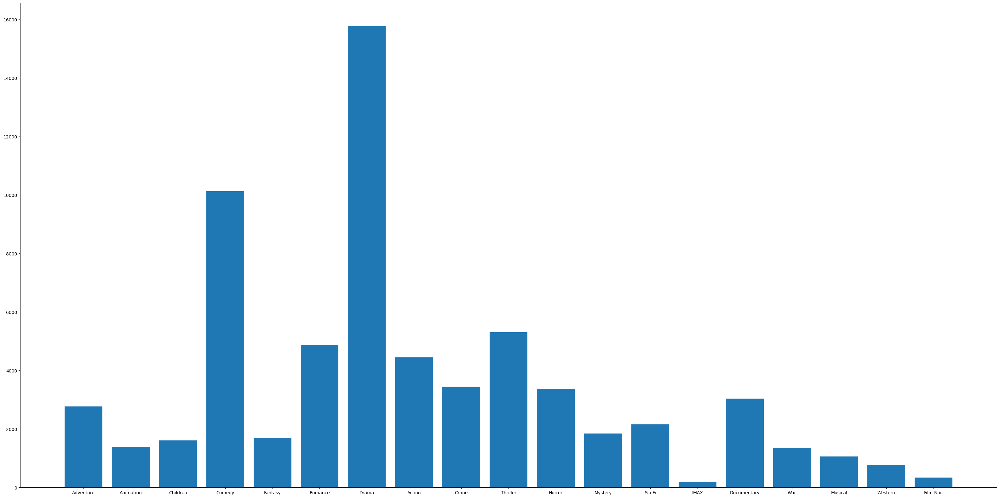

In [ ]:
## finding the unique values in the dataset. 
print(df_movies.nunique())
ct=0;
ls={};
## traverising each genre. 
for i in range(df_movies.shape[0]):
    if(df_movies['genres'][i]=='(no genres listed)'):
        df_movies['genres'][i]='NO GENRE';
    else:
## spliting the genres. 
        ss=df_movies['genres'][i];
        n=len(ss);
        j=0
        word="";
        while(j<n):
            if(ss[j]=='|'):
                j=j+1;
                if(word not in ls):
                    ls[word]=1;
                else:
                    ls[word]=ls[word]+1;
                word="";
            else:
                word=word+ss[j];
                j=j+1;                
        if(word not in ls):
            ls[word]=1;
        else:
            ls[word]=ls[word]+1;
ls1=[];
ls2=[];
for i in ls.keys():
    ls1.append(i);
    ls2.append(ls[i]);
## plotting the figure for genres vs the movies count.
plt_1 = plt.figure(figsize=(40, 20))
plt.bar(ls1,ls2);


## Doing oversampling of the dataset due to the genre problem

In [ ]:
## this function do the oversampling like duplicate the rows. 
df_movies2=(df_movies.set_index(['movieId' , 'title']).apply(lambda x: x.str.split('|').explode()).reset_index())
df_movies2

,movieId,title,genres
0,1,Toy Story (1995),Adventure
1,1,Toy Story (1995),Animation
2,1,Toy Story (1995),Children
3,1,Toy Story (1995),Comedy
4,1,Toy Story (1995),Fantasy
...,...,...,...
66663,151701,Bloodmoney (2010),NO GENRE
66664,151703,The Butterfly Circus (2009),Drama
66665,151709,Zero (2015),Drama
66666,151709,Zero (2015),Sci-Fi


## Extracting all type of genres. 

In [ ]:
ct=0;
ls=[];
## finding the unique of genrs. so split the string and get the uniques entries in all of the list. 
for i in range(df_movies.shape[0]):
        ss=df_movies['genres'][i];
        n=len(ss);
        j=0
        word="";
## traversing each line of string
        while(j<n):
            if(ss[j]=='|'):
                j=j+1;
                if(word not in ls):
                    ls.append(word);
                word="";
            else:
                word=word+ss[j];
                j=j+1;                
        if(word not in ls):
            ls.append(word);
print(ls);



['Adventure', 'Animation', 'Children', 'Comedy', 'Fantasy', 'Romance', 'Drama', 'Action', 'Crime', 'Thriller', 'Horror', 'Mystery', 'Sci-Fi', 'IMAX', 'Documentary', 'War', 'Musical', 'Western', 'Film-Noir', 'NO GENRE']


## assigning a new column of genre in the dataframe and filling its values. 

In [ ]:
## now create a new column named genres and then fill those columns. 
for i in ls:
    newcol=np.zeros([df_movies.shape[0],1]);
    df_movies[i]=newcol;
for i in range(df_movies.shape[0]):
        ss=df_movies['genres'][i];
        list_of=ss.split('|');
        for j in list_of:
            df_movies[j][i]=1;      

## droping the genre column that have string genres. 

In [ ]:
## droping the genres (string) column. 
df_movies=df_movies.drop('genres', axis='columns')

## handling the entries that are having same title but different genres.  like in this we are checking if a same title having the different genres. that is a fault in dataset. so we are combining there genres # if a movie A having x,y genre and movie B having y,z genre and we will assign A and B x,y,z genres. 

In [ ]:
mylist=df_movies['title'].unique();
# print(df_movies.nunique())
listt=df_movies.columns;
# print(listt);
lisst=[];
for k in listt:
    lisst.append(k);
lisst.remove('title');
lisst.remove('movieId');
## finding if any row has two title or not. if yes then equal both of the genres with union of both 
for j in mylist:
    newwd=df_movies[df_movies['title']==j] 
    listtf=newwd.index;
    if(newwd.shape[0]==2):
        for i in lisst:
            if(df_movies[i][listtf[0]]!=df_movies[i][listtf[1]]):
                df_movies[i][listtf[0]]=1;
                df_movies[i][listtf[1]]=1;
# print(df_movies);

In [ ]:
newcol=np.zeros([df_movies.shape[0],1]);
df_movies['released']=newcol;

for i in range(32918):
    if(i!=10603 and i!=15674 and i!=17376 and i!=19912 and i!=22471 and i!=22782 and i!=27991 and i!=28061 and i!=32394 and i!=32752
      and i!=22792 and i!=23771 and i!=23992 and  i!=24479 and i!=24608 and i!=27778 and i!=28005 and i!=28193 and i!=32717 and i!=32764
      and i!=27007 and i!=27024 and i!=27090 and i!=27249 and i!=27321 and i!=27358 and i!=27741 and i!=30166 and i!=31627 and i!=31946
      and i!=28884 and i!=28984 and i!=29298 and i!=29508 and i!=29510 and i!=29557  and i!=29740 and i!=29941 and i!=31561 and i!=31806
      and i!=30281 and i!=30285 and i!=31040 and i!=31103 and i!=31299 and i!=31317 and i!=31454 and i!=31512 and i!=31545 and i!=31598
      and i!=32767 and i!=32869 and i!=32879 and i!=32882 and i!=32909):        
        val=df_movies['title'][i];
        j=len(val)-1;
        year="";
        while(val[j]!=')' and (j>=0)):
            j=j-1;
        j=j-1;
        while((val[j]!='(') and (j>=0)):
            year=val[j]+year;
            j=j-1;
#         print(year);
#         yearr=float(year)
        df_movies['released'][i]=year;
    else:
       df_movies['released'][i]=2000;
for i in range(32919,df_movies.shape[0]):
    if(i!=34208):        
        val=df_movies['title'][i];
        j=len(val)-1;
        year="";
        while(val[j]!=')' and (j>=0)):
            j=j-1;
        j=j-1;
        while((val[j]!='(') and (j>=0)):
            year=val[j]+year;
            j=j-1;
#         yearr=float(year)
        df_movies['released'][i]=year;
    else:
       df_movies['released'][i]=2000;
df_movies

,movieId,title,Adventure,Animation,Children,Comedy,Fantasy,Romance,Drama,Action,...,Mystery,Sci-Fi,IMAX,Documentary,War,Musical,Western,Film-Noir,NO GENRE,released
0,1,Toy Story (1995),1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1995.0
1,2,Jumanji (1995),1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1995.0
2,3,Grumpier Old Men (1995),0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1995.0
3,4,Waiting to Exhale (1995),0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1995.0
4,5,Father of the Bride Part II (1995),0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1995.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34203,151697,Grand Slam (1967),0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1967
34204,151701,Bloodmoney (2010),0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2010
34205,151703,The Butterfly Circus (2009),0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2009
34206,151709,Zero (2015),0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2015


#Some Analysis using plots 

In [ ]:
unique_values = df_ratings["rating"].unique()
print(unique_values)

[2.5 3.  5.  3.5 4.  2.  1.  4.5 1.5 0.5]


In [ ]:
counts = []

for value in unique_values:
    count = df_ratings["rating"].value_counts()[value]
    counts.append(count)
print(counts)

[1044176, 4783899, 3358218, 2592375, 6265623, 1603254, 769654, 1813922, 337605, 315651]


<AxesSubplot:>

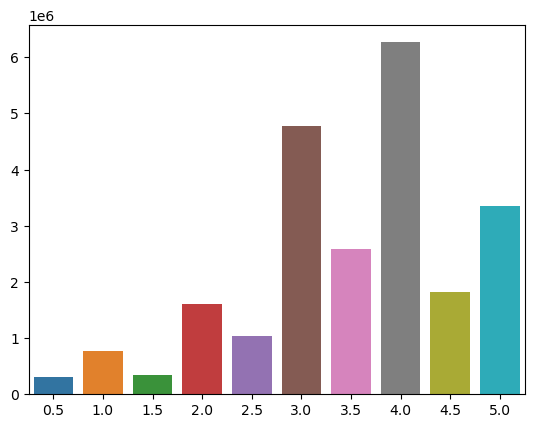

In [ ]:
sns.barplot(x=unique_values,y=counts)

In [ ]:
unique_df = pd.DataFrame({"value": unique_values, "count": counts})

In [ ]:
unique_df

,value,count
0,2.5,1044176
1,3.0,4783899
2,5.0,3358218
3,3.5,2592375
4,4.0,6265623
5,2.0,1603254
6,1.0,769654
7,4.5,1813922
8,1.5,337605
9,0.5,315651


In [ ]:
# df_ratings.plot.pie(y='rating',figsize=(10,10))

  0%|          | 0/819 [00:00<?, ?it/s]


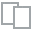
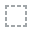
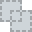
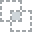
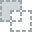
...
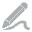
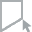
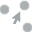
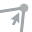
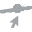

In [ ]:
report_retail = create_report(rating)
report_retail.show()

  0%|          | 0/456 [00:00<?, ?it/s]


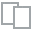
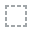
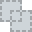
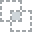
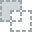
...
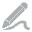
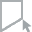
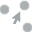
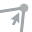
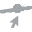

In [ ]:
report_retail = create_report(df_movies)
report_retail.show()

# **Combined Datasets**

In [ ]:
movies_merged=pd.merge(df_updated_mb,df_movies, on="movieId");
movies_merged
movies_merged=movies_merged.drop(columns=['title'])
movies_merged['released'] = pd.to_numeric(movies_merged['released']);
movies_merged['released']=movies_merged['released'].fillna(2000)
movies_merged

,movieId,"(rating, count)",rating,Adventure,Animation,Children,Comedy,Fantasy,Romance,Drama,...,Mystery,Sci-Fi,IMAX,Documentary,War,Musical,Western,Film-Noir,NO GENRE,released
0,1,60424,3.894802,1.0,1.0,1.0,1.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1995.0
1,2,23950,3.221086,1.0,0.0,1.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1995.0
2,3,15267,3.180094,0.0,0.0,0.0,1.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1995.0
3,4,2935,2.879727,0.0,0.0,0.0,1.0,0.0,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1995.0
4,5,14769,3.080811,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1995.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33665,151697,1,3.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1967.0
33666,151701,1,4.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2010.0
33667,151703,1,5.000000,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2009.0
33668,151709,1,3.500000,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2015.0


In [ ]:
df_tags2=df_tags.drop(['year','month'],axis=1)
user_merged_temp=pd.merge(df_tags2,df_ratings, on=["userId",'movieId']);
user_merged=pd.merge(user_merged_temp,df_movies, on=['movieId']);
user_merged['released'] = pd.to_numeric(user_merged['released']);
user_merged2=user_merged.drop(['title'], axis='columns')
user_merged2['released']=user_merged2['released'].fillna(user_merged2['released'].mode())
user_merged

,userId,movieId,tag,rating,year,month,title,Adventure,Animation,Children,...,Mystery,Sci-Fi,IMAX,Documentary,War,Musical,Western,Film-Noir,NO GENRE,released
0,23,7075,30569,5.0,18,9,"Court Jester, The (1956)",1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1956.0
1,23,7075,19535,5.0,18,9,"Court Jester, The (1956)",1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1956.0
2,11846,7075,1728,4.5,8,12,"Court Jester, The (1956)",1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1956.0
3,11846,7075,2443,4.5,8,12,"Court Jester, The (1956)",1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1956.0
4,11846,7075,4972,4.5,8,12,"Court Jester, The (1956)",1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1956.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
498931,247674,150230,22454,0.5,21,1,Cool Cat Saves the Kids (2015),1.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2015.0
498932,247700,4856,5566,4.5,12,2,Destiny in Space (1994),0.0,0.0,0.0,...,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1994.0
498933,247700,4856,11438,4.5,12,2,Destiny in Space (1994),0.0,0.0,0.0,...,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1994.0
498934,247700,4856,40697,4.5,12,2,Destiny in Space (1994),0.0,0.0,0.0,...,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1994.0


## 1. First we will make a general recommender like if a new user login is happenning. then we will recommend him the best movies based on the rating and releasing date of that movie. 

In [ ]:
def general_recommender(dataset,no_of_movies):
    ## sorting the movies based on their rating and streaming year and popularity. 
    new_dataset=dataset.sort_values(by = [('rating', 'count'),'rating','released'],ascending = False);
    listt=new_dataset.index;   
    
     ## now just extract the movie title with the movie id.
    final_dataset2=df_movies[df_movies['movieId']==new_dataset['movieId'][listt[0]]]
    for i in range(1,no_of_movies):
        dataf=df_movies[df_movies['movieId']==new_dataset['movieId'][listt[i]]]
        final_dataset2=pd.concat([dataf,final_dataset2]);
    return final_dataset2['title'].head(no_of_movies);

general_recommender(movies_merged,100)

2245                            American History X (1998)
907                          2001: A Space Odyssey (1968)
5349                               Minority Report (2002)
1625                              Truman Show, The (1998)
3903    Crouching Tiger, Hidden Dragon (Wo hu cang lon...
                              ...                        
476                                  Jurassic Park (1993)
587                      Silence of the Lambs, The (1991)
315                      Shawshank Redemption, The (1994)
293                                   Pulp Fiction (1994)
352                                   Forrest Gump (1994)
Name: title, Length: 100, dtype: object

### 2.Recommender based on generes. like we are recommending movies if any user is giving us his favourite genres. 

In [ ]:
def genres_based_recommender(dataset,no_of_movies,genres):
    ## here we are just getting the top movies with 1st genre
    final_dataset=dataset[dataset[genres[0]]==1];
    final_dataset=final_dataset.sort_values(by = [('rating', 'count'),'rating','released'],ascending = False)
    final_datset=final_dataset.head(100);
    
    ## now getting the top 100 movies for every genres and the sort them and merge them 
    for i in range(1,len(genres)):
        new_dataset=dataset[dataset[genres[i]]==1];
        new_dataset=new_dataset.sort_values(by =[('rating', 'count'),'rating','released'],ascending = False)
        new_dataset=new_dataset.head(100);
        final_dataset=pd.merge(final_dataset,new_dataset,on =['movieId'])
        
    ## again sort the final dataset and got best movies based on these gneres. 
    final_dataset=final_dataset.sort_values(by =[('rating', 'count'),'rating','released'],ascending = False)

    ## having the index of every movie id 
    listt=final_dataset.index;    
    
     ## now just extract the movie title with the movie id.
    final_dataset2=df_movies[df_movies['movieId']==final_dataset['movieId'][listt[0]]]
    for i in range(1,no_of_movies):
        dataf=df_movies[df_movies['movieId']==final_dataset['movieId'][listt[i]]]
        final_dataset2=pd.concat([dataf,final_dataset2]);
    return final_dataset2['title'].head(no_of_movies);

genres_based_recommender(movies_merged,7,['Adventure','Animation','Children'])

3028       Toy Story 2 (1999)
6272      Finding Nemo (2003)
4791    Monsters, Inc. (2001)
4212             Shrek (2001)
360     Lion King, The (1994)
582            Aladdin (1992)
0            Toy Story (1995)
Name: title, dtype: object

## 3. Now we will make a function that will recommend us movies if we give a movie name to the function. this function will recommend movies that are highly correlated to the input movie

In [ ]:
def movie_based(dataset,no_of_movies,moviename):       
    newdataset=dataset.pivot_table(index=['userId'],columns=['title'],values=['rating']);
    newd=newdataset[('rating',moviename)];    
    correlation=newdataset.corrwith(newd).sort_values(ascending=False);
    listt=correlation.head(no_of_movies);
    print(listt);
movie_based(user_merged,5,'Jumanji (1995)');

        title                     
rating  Treasure Planet (2002)        1.0
        Jumanji (1995)                1.0
        Three Wishes (1995)           1.0
        Little Rascals, The (1994)    1.0
        Lost Weekend, The (1945)      1.0
dtype: float64


# 4. using clustering algorithm to recommend movies basically we are clustering all the movies based on there generes and year of released and the ratings. than if we have a used that is asking for a movie similiar to a given movie we will recommend him the movies belong to that cluster sorted by there ratings and there rating counts. 

## elbow mehtod

        userId  movieId    tag  rating  year  month  Adventure  Animation  \
0           23     7075  30569     5.0    18      9        1.0        0.0   
1           23     7075  19535     5.0    18      9        1.0        0.0   
2        11846     7075   1728     4.5     8     12        1.0        0.0   
3        11846     7075   2443     4.5     8     12        1.0        0.0   
4        11846     7075   4972     4.5     8     12        1.0        0.0   
...        ...      ...    ...     ...   ...    ...        ...        ...   
498931  247674   150230  22454     0.5    21      1        1.0        0.0   
498932  247700     4856   5566     4.5    12      2        0.0        0.0   
498933  247700     4856  11438     4.5    12      2        0.0        0.0   
498934  247700     4856  40697     4.5    12      2        0.0        0.0   
498935  247700     4856  18298     4.5    12      2        0.0        0.0   

        Children  Comedy  ...  Mystery  Sci-Fi  IMAX  Documentary  War  \
0

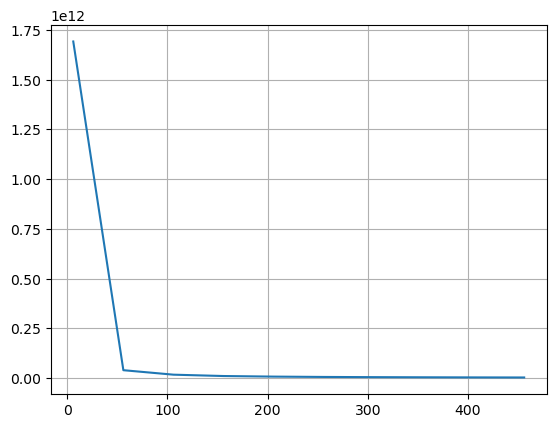

In [ ]:
from sklearn.decomposition import PCA
from numpy.linalg import eig
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import MinMaxScaler
print(user_merged2)

def find_best_clusters(data):
    list_of_cluster=[];
    for i in range(6,500,50):
        list_of_cluster.append(i);
    store_out=[]; ## in this list appending the values 
    score_mat=[];
    for i in list_of_cluster:
        model=KMeans(n_clusters=i); ## now traing and fit the modle 
        model=model.fit(data);
        moo=model.predict(data);
        acci=model.inertia_;   ## predict the inerial value. 
        store_out.append(acci);# print(slis);  
    plt.plot(list_of_cluster,store_out);
    plt.grid(); ## plot it in a grid 
    plt.show();

find_best_clusters(movies_merged)

## recommending movies by using Kmeans algorithm as a subpart of our problem 

# Kmeans

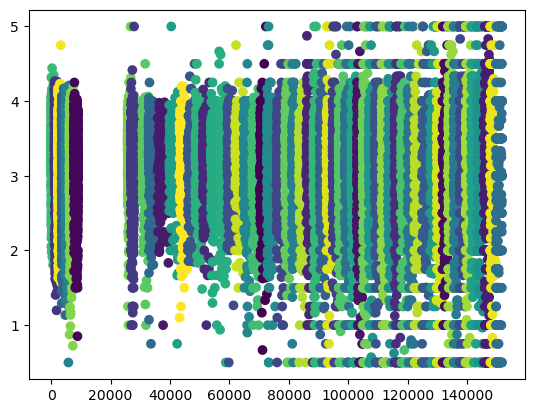

The Silhoutee Score for K-means  is  0.5457016408720748
The value of calinski_harabasz score for K-means on PCA reduced dataset is  173531.58847131874
The value of davies_bouldin score for K-means on PCA reduced dataset is  0.9357318811683613
['Toy Story (1995)', 'Grumpier Old Men (1995)', 'Waiting to Exhale (1995)', 'Father of the Bride Part II (1995)', 'Heat (1995)', 'Sabrina (1995)', 'Tom and Huck (1995)', 'Sudden Death (1995)', 'GoldenEye (1995)', 'American President, The (1995)', 'Dracula: Dead and Loving It (1995)', 'Balto (1995)', 'Nixon (1995)', 'Cutthroat Island (1995)', 'Casino (1995)', 'Sense and Sensibility (1995)', 'Four Rooms (1995)', 'Ace Ventura: When Nature Calls (1995)', 'Money Train (1995)']


In [ ]:
from sklearn.preprocessing import MinMaxScaler
import plotly.graph_objects as go
## as we got the best no. of clusters now we will train our final model and will get the desired results. 
def find_based_on_clustering(data,no_of_cluster,moviename,no_of_movies,fl):
    
    ## finding the movieId the the name of movie;
    model_trained=KMeans(n_clusters=no_of_cluster); ## now traing and fit the modle 
    
    ## training the model 
    scale=MinMaxScaler(feature_range=(0, 5));
    data2=data.copy();
    
    data22=data2[('rating', 'count')]
    data22=pd.DataFrame(data22, columns=[('rating', 'count')]);
    data2=data2.drop(columns=[('rating', 'count')])
    data22=scale.fit_transform(data22.to_numpy())
#     data2[]
    data22=pd.DataFrame(data22, columns=[('rating', 'count')]);
    data22=pd.concat([data22,data2],1)
   
    model_trained=model_trained.fit(data22);
    classes=model_trained.predict(data22);
    
    ## adding a now column of class in which we are storing that a given movie belonging to which cluster. 
    movies_merged2=data22.copy();
    movies_merged2['classes']=(np.array(classes)).transpose()
        
    given_frame=df_movies[df_movies['title']==moviename]
    given_id=given_frame['movieId'][given_frame.index[0]];

    the_frame=movies_merged2[movies_merged2['movieId']==given_id];
    the_class=the_frame['classes'][the_frame.index[0]];
    
    listt = model_trained.cluster_centers_   
    listt=pd.DataFrame(listt);  
    
    the_selected_movie_set=movies_merged2[movies_merged2['classes']==the_class];
    the_selcted_movie_set=the_selected_movie_set.sort_values(by = ['rating','released'],ascending = False)
    from sklearn.preprocessing import LabelEncoder
    le=LabelEncoder();
    movies_merged2['released'] = le.fit_transform(movies_merged2['released']);
    plt.scatter(movies_merged2.iloc[:,1],movies_merged2.iloc[:,2],c=classes)
#     plt.scatter(listt.iloc[:,0],listt.iloc[:,1],color='red');
    plt.show();
    fig = go.Figure(data=[
        go.Scatter3d(
            x=movies_merged2.iloc[:,1].to_numpy(), y=movies_merged2.iloc[:,2].to_numpy(), z=movies_merged2.iloc[:,movies_merged.shape[1]-2].to_numpy(),
            mode='markers',
            marker=dict(size=5, color=classes, opacity=1)
        ),])
    fig.show();
    the_final_output=the_selected_movie_set.head(no_of_movies);
#     print(the_final_output);
    
    listt=[];
    for i in range(len(the_final_output.index)):
        the_id=the_final_output['movieId'][the_final_output.index[i]];
        given_frame=df_movies[df_movies['movieId']==the_id]
        given_movie=given_frame['title'][given_frame.index[0]];
        listt.append(given_movie);
    listt.remove(moviename);
    
    if(fl==1):
        the_silhoutee_score =silhouette_score(movies_merged2,classes) 

        print("The Silhoutee Score for K-means  is ",the_silhoutee_score);

        from sklearn.metrics import davies_bouldin_score
        from sklearn.metrics import calinski_harabasz_score

        ## computing other type of scores. 

        s = calinski_harabasz_score(movies_merged,classes)
        DB = davies_bouldin_score(movies_merged,classes)
        print("The value of calinski_harabasz score for K-means on PCA reduced dataset is ",s);
        print("The value of davies_bouldin score for K-means on PCA reduced dataset is ",DB)
    return listt;

print(find_based_on_clustering(movies_merged,60,'Jumanji (1995)',20,1))


## 5. recommending movies by using Hierarichal clustering as a subpart of our algorithm

In [ ]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.cluster import AgglomerativeClustering;
## as we got the best no. of clusters now we will train our final model and will get the desired results. 
def find_based_on_clustering2(data,no_of_cluster,moviename,no_of_movies,fl):
    
    model_trained=AgglomerativeClustering(n_clusters=no_of_cluster,linkage='single')
    ## training the model getting negative silhuttoe score withscalling
    
    scale=MinMaxScaler(feature_range=(0, 5));
    data2=data.copy();
    data22=data2[('rating', 'count')]
    data22=pd.DataFrame(data22, columns=[('rating', 'count')]);
    data2=data2.drop(columns=[('rating', 'count')])
    data22=scale.fit_transform(data22.to_numpy())
    data22=pd.DataFrame(data22, columns=[('rating', 'count')]);
    data22=pd.concat([data22,data2],1)   
    classes=model_trained.fit_predict(data22);
    
    ## adding a now column of class in which we are storing that a given movie belonging to which cluster. 
    movies_merged2=data22.copy();
    movies_merged2['classes']=(np.array(classes)).transpose(); 
        
    given_frame=df_movies[df_movies['title']==moviename]
    given_id=given_frame['movieId'][given_frame.index[0]];
    
    the_frame=movies_merged2[movies_merged2['movieId']==given_id];
    the_class=the_frame['classes'][the_frame.index[0]];
    
    the_selected_movie_set=movies_merged2[movies_merged2['classes']==the_class];
    the_selcted_movie_set=the_selected_movie_set.sort_values(by = ['rating','released'],ascending = False)
    
    the_final_output=the_selected_movie_set.head(no_of_movies);
#     print(the_final_output);
    
    listt=[];
    for i in range(len(the_final_output.index)):
        the_id=the_final_output['movieId'][the_final_output.index[i]];
        given_frame=df_movies[df_movies['movieId']==the_id]
        given_movie=given_frame['title'][given_frame.index[0]];
        listt.append(given_movie);
    listt.remove(moviename);
    
    if(fl==1):
        the_silhoutee_score =silhouette_score(movies_merged2,classes) 

        print("The Silhoutee Score for K-means  is ",the_silhoutee_score);

        from sklearn.metrics import davies_bouldin_score
        from sklearn.metrics import calinski_harabasz_score

        ## computing other type of scores. 

        s = calinski_harabasz_score(movies_merged,classes)
        DB = davies_bouldin_score(movies_merged,classes)
        print("The value of calinski_harabasz score for K-means on PCA reduced dataset is ",s);
        print("The value of davies_bouldin score for K-means on PCA reduced dataset is ",DB)
    return listt
print(find_based_on_clustering2(movies_merged,60,'Jumanji (1995)',20,1))

The Silhoutee Score for K-means  is  0.30916887435410817
The value of calinski_harabasz score for K-means on PCA reduced dataset is  42495.82499995974
The value of davies_bouldin score for K-means on PCA reduced dataset is  1.3046728308634494
['Toy Story (1995)', 'Grumpier Old Men (1995)', 'Waiting to Exhale (1995)', 'Father of the Bride Part II (1995)', 'Heat (1995)', 'Sabrina (1995)', 'Tom and Huck (1995)', 'Sudden Death (1995)', 'GoldenEye (1995)', 'American President, The (1995)', 'Dracula: Dead and Loving It (1995)', 'Balto (1995)', 'Nixon (1995)', 'Cutthroat Island (1995)', 'Casino (1995)', 'Sense and Sensibility (1995)', 'Four Rooms (1995)', 'Ace Ventura: When Nature Calls (1995)', 'Money Train (1995)']


## 6. collaborative filtering
  


## 6a (based on clustering)

In [ ]:
def collaborative(userid,dataset):
    newdataset=dataset.pivot_table(index=['userId'],columns=['movieId'],values=['rating']);
    new_user_data=newdataset.loc[newdataset.index==userid];
    
    listt=new_user_data.isnull().sum();
    total_movies=[];
    for j in new_user_data.columns:
        if(new_user_data[j].isnull().values.any()==False):
            total_movies.append(j);
            
    df_new=newdataset[total_movies[0]]
    for i in range(1,len(total_movies)):
        df_neww=newdataset[total_movies[i]];
        df_new=pd.concat([df_new,df_neww],axis=1);
    
    ## got the new dataframe that are having coloumn of only the movies watched by given user.
    user_count = df_new.T.notnull().sum()
    user_count = user_count.reset_index()
    user_count.columns = ["userId", "movie_count"]
    user_count=user_count.sort_values(by=["movie_count"],ascending=False)

    the_related_user=user_count['userId'][user_count.index[1]];
    
    the_dataset=user_merged[user_merged['userId']==the_related_user]
    
    the_dataset=the_dataset.sort_values(by=['rating','released'],ascending=False)
    
    so_the_best_movie=the_dataset['title'][the_dataset.index[0]];
#     movie_based(user_merged,100,so_the_best_movie)
    list1 = find_based_on_clustering2(movies_merged,60,'Jumanji (1995)',100,0)
    list2 = find_based_on_clustering2(movies_merged,60,'Jumanji (1995)',100,0)
    
## we have the movies recommended by both models.
    user_movies=user_merged[user_merged['userId']==11846]['title'].unique()
    newlistt=[];
    for j in list2:
        if(j in list1 and j not in user_movies):
            newlistt.append(j);
    return newlistt[0:15];
   
    
print(collaborative(11846,user_merged))

['Toy Story (1995)', 'Grumpier Old Men (1995)', 'Waiting to Exhale (1995)', 'Father of the Bride Part II (1995)', 'Heat (1995)', 'Sabrina (1995)', 'Tom and Huck (1995)', 'Sudden Death (1995)', 'GoldenEye (1995)', 'American President, The (1995)', 'Dracula: Dead and Loving It (1995)', 'Balto (1995)', 'Nixon (1995)', 'Cutthroat Island (1995)', 'Casino (1995)']


## colaborative filtering (second type). 

In [ ]:
def collaborative2(userid,dataset):
    ## making the pivot table
    newdataset=dataset.pivot_table(index=['userId'],columns=['movieId'],values=['rating']);
    new_user_data=newdataset.loc[newdataset.index==userid];
    
    ## finding the total movies watched by given user. 
    listt=new_user_data.isnull().sum();
    total_movies=[];
    for j in new_user_data.columns:
        if(new_user_data[j].isnull().values.any()==False):
            total_movies.append(j);
     
    ## finding the new dataset that has only the movies wathced by user as column .
    df_new=newdataset[total_movies[0]]
    for i in range(1,len(total_movies)):
        df_neww=newdataset[total_movies[i]];
        df_new=pd.concat([df_new,df_neww],axis=1);
    
    ## got the new dataframe that are having coloumn of only the movies watched by given user.
    user_count = df_new.T.notnull().sum()
    user_count = user_count.reset_index()
    user_count.columns = ["userId", "movie_count"]
    user_count=user_count.sort_values(by=["movie_count"],ascending=False)

    the_related_user=user_count['userId'][user_count.index[1]];
    
    the_dataset=user_merged[user_merged['userId']==the_related_user]
    
    the_dataset=the_dataset.sort_values(by=['rating','released'],ascending=False)
    
    so_the_best_movie=the_dataset['title'][the_dataset.index[0]];
    movie_based(user_merged,10,so_the_best_movie)

collaborative2(11846,user_merged)

        title                                            
rating  Pacifier, The (2005)                                 1.0
        Frank (2014)                                         1.0
        You're Next (2011)                                   1.0
        Five, The (Gonin) (1995)                             1.0
        Fletch (1985)                                        1.0
        Phoebe in Wonderland (2008)                          1.0
        Follow That Dream (1962)                             1.0
        What Time Is It There? (Ni neibian jidian) (2001)    1.0
        Basic Instinct 2 (2006)                              1.0
        Phantasm (1979)                                      1.0
dtype: float64


In [ ]:
duplicate_movies=df_movies[df_movies.duplicated(subset='title',keep=False)]
duplicate_movies

,movieId,title,genres
582,588,Aladdin (1992),Adventure|Animation|Children|Comedy|Musical
823,838,Emma (1996),Comedy|Drama|Romance
1716,1788,Men with Guns (1997),Action|Drama
3508,3598,Hamlet (2000),Crime|Drama|Romance|Thriller
5168,5264,Clockstoppers (2002),Action|Adventure|Sci-Fi|Thriller
5905,6003,Confessions of a Dangerous Mind (2002),Comedy|Crime|Drama|Thriller
9139,26958,Emma (1996),Romance
9154,26982,Men with Guns (1997),Drama
9949,32600,Eros (2004),Drama
10231,34048,War of the Worlds (2005),Action|Adventure|Sci-Fi|Thriller


In [ ]:
df_tags2=df_tags.drop(['year','month'],axis=1)
user_merged_temp=pd.merge(df_tags2,df_ratings, on=["userId",'movieId']);
user_merged=pd.merge(user_merged_temp,df_movies, on=['movieId']);
user_merged

,userId,movieId,tag,rating,year,month,title,Adventure,Animation,Children,...,Mystery,Sci-Fi,IMAX,Documentary,War,Musical,Western,Film-Noir,NO GENRE,released
0,23,7075,30569,5.0,18,9,"Court Jester, The (1956)",1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1956.0
1,23,7075,19535,5.0,18,9,"Court Jester, The (1956)",1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1956.0
2,11846,7075,1728,4.5,8,12,"Court Jester, The (1956)",1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1956.0
3,11846,7075,2443,4.5,8,12,"Court Jester, The (1956)",1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1956.0
4,11846,7075,4972,4.5,8,12,"Court Jester, The (1956)",1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1956.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
498931,247674,150230,22454,0.5,21,1,Cool Cat Saves the Kids (2015),1.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2015
498932,247700,4856,5566,4.5,12,2,Destiny in Space (1994),0.0,0.0,0.0,...,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1994.0
498933,247700,4856,11438,4.5,12,2,Destiny in Space (1994),0.0,0.0,0.0,...,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1994.0
498934,247700,4856,40697,4.5,12,2,Destiny in Space (1994),0.0,0.0,0.0,...,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1994.0


# **Other Supervised Models**

## **XGBoost Model**
Predictiong new movie based on information about the movie like Genre, Released_Year_Band, Tag, Times_Watched, Rating,User_data

In [ ]:
user_merged2=user_merged;
print("NULL values in the dataset:\n",user_merged2.isnull().sum());
user_merged2=user_merged2.dropna()
user_merged2['released'] = pd.to_numeric(user_merged2['released']);
user_merged2['released'].replace({0:'2000','nan':'2000'}, inplace=True)

NULL values in the dataset:
 userId         0
movieId        0
tag            0
rating         0
year           0
month          0
title          0
Adventure      0
Animation      0
Children       0
Comedy         0
Fantasy        0
Romance        0
Drama          0
Action         0
Crime          0
Thriller       0
Horror         0
Mystery        0
Sci-Fi         0
IMAX           0
Documentary    0
War            0
Musical        0
Western        0
Film-Noir      0
NO GENRE       0
released       0
dtype: int64


In [ ]:
# print(user_merged2['released'].min());
# print(user_merged2['released'].max());
# print(user_merged['released'].unique())

In [ ]:
# Code for Binning
# user_merged.loc[user_merged['released'].between(1892, 1950, 'both'), 'released_interval'] = '1892-1950'
# user_merged.loc[user_merged['released'].between(1950, 1990, 'right'), 'released_interval'] = '1950-1990'
# user_merged.loc[user_merged['released'].between(1990, 2005, 'right'),'released_interval'] = '1990-2005'

In [ ]:
user_merged2.drop(columns=['title','userId'],inplace=True);
user_mergedx=user_merged2.drop(columns=['movieId']);
user_mergedy=user_merged2['movieId'];

In [ ]:
xuser_train,xuser_test,yuser_train,yuser_test=train_test_split(user_mergedx.iloc[:50000,:],user_mergedy.iloc[:50000],test_size=0.20);
xuser_train

,tag,rating,year,month,Adventure,Animation,Children,Comedy,Fantasy,Romance,...,Mystery,Sci-Fi,IMAX,Documentary,War,Musical,Western,Film-Noir,NO GENRE,released
41598,41604,4.0,14,4,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1998.0
8461,28143,1.0,16,4,1.0,1.0,1.0,1.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1995.0
25352,21970,5.0,20,11,0.0,0.0,0.0,1.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2001.0
30491,24218,5.0,17,3,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2008.0
30215,4307,4.5,20,8,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2008.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24109,30761,4.0,15,1,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2000.0
30776,42807,4.0,20,10,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2008.0
37085,43919,5.0,20,3,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1994.0
15808,42444,4.0,11,12,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1991.0


In [ ]:
user_merged2['year'] = pd.to_numeric(user_merged2['year']);
user_merged2['month'] = pd.to_numeric(user_merged2['month']);

In [ ]:
cols_to_scale=['rating','year','month','released'];
standard_scaler=StandardScaler();
standard_scaler.fit(xuser_train)
xuser_train2=standard_scaler.fit_transform(xuser_train);
xuser_test2=standard_scaler.fit_transform(xuser_test);
xuser_train2

array([[ 1.2088897 , -0.23367169, -0.70136112, ..., -0.04420192,
         0.        ,  0.21390336],
       [ 0.05111229, -3.60921081, -0.14318035, ..., -0.04420192,
         0.        , -0.06742812],
       [-0.47982597,  0.89150801,  0.97318121, ..., -0.04420192,
         0.        ,  0.49523485],
       ...,
       [ 1.4080023 ,  0.89150801,  0.97318121, ..., -0.04420192,
         0.        , -0.16120529],
       [ 1.2811379 , -0.23367169, -1.53863229, ..., -0.04420192,
         0.        , -0.44253677],
       [-0.15101065, -0.23367169, -0.14318035, ..., -0.04420192,
         0.        , -0.16120529]])

In [ ]:
le=LabelEncoder();
y_values = le.fit_transform(yuser_train);

In [ ]:
XGB_model=XGBClassifier();
XGB_model.fit(xuser_train2,y_values);

In [ ]:
def XGB_classifier(XGB_model,xuser_test2,df_movie_Id,xuser_test):
    yuser_pred=XGB_model.predict(xuser_test2);
    yuser_pred_df=pd.DataFrame(yuser_pred,columns=['movieId']);
    xuser_test['movieId']=yuser_pred;
    user_merged1=pd.merge(xuser_test,df_movie_Id, on=['movieId']);
    
    return user_merged1

XGB_classifier(XGB_model,xuser_test2,df_movie_Id,xuser_test)

,tag,rating,year,month,Adventure,Animation,Children,Comedy,Fantasy,Romance,...,IMAX,Documentary,War,Musical,Western,Film-Noir,NO GENRE,released,movieId,title
0,26107,4.0,16,6,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2001.0,53,Lamerica (1994)
1,20124,5.0,20,9,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2001.0,53,Lamerica (1994)
2,26097,3.5,18,5,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2001.0,53,Lamerica (1994)
3,34824,5.0,18,6,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2001.0,53,Lamerica (1994)
4,23329,2.0,18,6,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2001.0,53,Lamerica (1994)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9836,35224,3.0,20,10,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2003.0,64,Two if by Sea (1996)
9837,35224,1.0,18,3,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2003.0,64,Two if by Sea (1996)
9838,43219,0.5,17,1,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,2009.0,106,Nobody Loves Me (Keiner liebt mich) (1994)
9839,44263,3.0,15,4,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,2009.0,96,In the Bleak Midwinter (1995)


# **Decision Tree Model**
Working on User and movie dataset with time of watching to get new movie prediction

In [ ]:
df_user_ratings
df_user_movie=df_user_ratings.drop(columns=['year','month','rating']);
user_merged3=pd.merge(df_updated_mb,df_user_movie, on=['movieId']);
df_movies_up=df_movies.loc[:,['movieId','released']];
user_merged4=pd.merge(df_movies_up,user_merged3, on=['movieId']);
df_movies_up

,movieId,released
0,1,1995.0
1,2,1995.0
2,3,1995.0
3,4,1995.0
4,5,1995.0
...,...,...
34203,151697,1967
34204,151701,2010
34205,151703,2009
34206,151709,2015


In [ ]:
print("NULL values in the dataset:\n",user_merged4.isnull().sum());
user_merged4=user_merged4.dropna()

NULL values in the dataset:
 movieId            0
released           0
(rating, count)    0
rating             0
userId             0
dtype: int64


In [ ]:
def Decision_tree_classifer(user_merged4,df_movie_Id,user_input):
    #taking movies which are already watched by the user (not to recommand)
    data_temp=user_merged4[user_merged4['userId']==user_input];
    movie_row=np.array(data_temp['movieId']);
    rows,cols=user_merged4.shape;
    data_x=data_temp.drop(columns=['movieId']);
    data_x['rating']=5;
    
    # k decision Tree Classifiers
    recommand_movies=[];
    for j in range(0,5):
        dt_classifier=DecisionTreeClassifier();
        user_merged5=user_merged4.sample(n=50000);
        user_y=user_merged5['movieId'];
        user_x=user_merged5.drop(columns=['movieId']);
        
        #Fitting the model
        print("reached here!!!")
        dt_classifier.fit(user_x,user_y);
        predict_val=dt_classifier.predict(data_x);
#         print(predict_val)
        r_movies=[];
        for i in range(0,len(predict_val)):
            if predict_val[i] not in recommand_movies:
                if predict_val[i] not in movie_row:
                    recommand_movies.append(predict_val[i]);
#     out_movies=[];
#     for i in range(0,len(recommand_movies)):
#         if(recommand_movies.count(recommand_movies[i])>1):
#             if recommand_movies[i] not in out_movies:
#                 out_movies.append(recommand_movies[i])
    recommand_df=pd.DataFrame(recommand_movies,columns=['movieId']);
    recommand_merged=pd.merge(recommand_df,df_movie_Id, on=['movieId']);
    return recommand_merged;
    

user_merged41=user_merged4.drop(columns=[(  'rating', 'count')]);
user_merged41['rating_count']=user_merged4[(  'rating', 'count')]; 
Decision_tree_classifer(user_merged41,df_movie_Id,11846)

reached here!!!
reached here!!!
reached here!!!
reached here!!!
reached here!!!


,movieId,title
0,126967,Letter from Siberia (1957)
1,146335,Sem Pena (2014)
2,100315,2 Become 1 (Tin sun yut dui) (2006)
3,109529,Everybody Street (2013)
4,133323,The Fruit Hunters (2012)
5,146016,Elder Sister (1966)


In [ ]:
Decision_tree_classifer(user_merged41,df_movie_Id,2)

reached here!!!
reached here!!!
reached here!!!
reached here!!!
reached here!!!


,movieId,title
0,318,"Shawshank Redemption, The (1994)"
1,137612,Babai (2015)
2,1212,"Third Man, The (1949)"
3,132448,Einstein (2015)
4,2019,Seven Samurai (Shichinin no samurai) (1954)
5,141373,The Battle of Chernobyl (2006)
6,1041,Secrets & Lies (1996)


# **Neural Network Based Model**

In [ ]:
import tensorflow.compat.v1 as tf
tf.compat.v1.disable_eager_execution()
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA

In [ ]:
# df_movie_Id['index'] = df_movie_Id.index
# df_movie_Id2=df_movie_Id.iloc[:100,:]
# df_movie_Id2
movies_merg=movies_merged.loc[:,['movieId','rating']];
movies_merg['count']=movies_merged[('rating', 'count')];
movies_mergy=movies_merg['movieId'];
movies_mergx=movies_merg.drop(columns=['movieId']);
mm_scaler=MinMaxScaler();
mm_scaler.fit(movies_mergx);
movies_mergx2=mm_scaler.fit_transform(movies_mergx);

movies_mergx2=pd.DataFrame(movies_mergx2,columns=['rating','count']);
# pca=PCA(n_components=1);
# pca.fit(movies_mergx2);
# movies_mergx3=pca.transform(movies_mergx2);
# movies_merg3=pd.DataFrame(movies_mergx3,columns=['rating']);
movies_mergx2.loc[:,'rating'] = movies_mergx2.loc[:,'rating'].add(movies_mergx2.loc[:,'count'])
# movies_mergx2['rating']=movies_mergx2['rating2']+movies_mergx2['count']/2;
movies_mergx2['movieId']=movies_mergy;
movies_mergx2=movies_merg.drop(columns=['count']);
movies_mergx2['index'] = movies_mergx2.index
df_movie_Id2=movies_mergx2.iloc[:1000,:]
df_movie_Id2

,movieId,rating,index
0,1,3.894802,0
1,2,3.221086,1
2,3,3.180094,2
3,4,2.879727,3
4,5,3.080811,4
...,...,...,...
995,1014,3.371480,995
996,1015,3.267987,996
997,1016,3.127899,997
998,1017,3.504210,998


In [ ]:
df_ratings3=df_ratings2.drop(columns=['rating']);
merged_data = df_movie_Id2.merge(df_ratings3.iloc[:3500000,:], on='movieId');
merged_data.drop(columns=['year','month'],inplace=True);
user_grouped = merged_data.groupby('userId');
user_grouped.head()

,movieId,rating,index,userId
0,1,3.894802,0,15
1,1,3.894802,0,17
2,1,3.894802,0,23
3,1,3.894802,0,28
4,1,3.894802,0,34
...,...,...,...,...
914999,1018,3.062156,999,21812
915011,1018,3.062156,999,25181
915019,1018,3.062156,999,26753
915023,1018,3.062156,999,27122


transforming the data for input to RBM

In [ ]:
print(merged_data['index'].unique());
print(len(merged_data['movieId'].unique()));
train_list=[];
len_moviedata2=len(df_movie_Id)
len_moviedata=len(merged_data['movieId'].unique());
# number_of_users=1000;
for userId,curr_user in user_grouped:
    #Storing rating of every movie
    store=[0]*len_moviedata;
    for num ,movie in curr_user.iterrows():
#         print(num);
#         print(movie);
#         print(movie['index'])
        store[int(movie['index'])] = movie['rating']/4.0
    train_list.append(store);
# print(train_list)

[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197
 198 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215
 216 217 218 219 220 221 222 223 224 225 226 227 228 229 230 231 232 233
 234 235 236 237 238 239 240 241 242 243 244 245 24

In [ ]:
number_of_hl=10;
number_of_vl=len_moviedata;
vb = tf.placeholder("float",[number_of_vl]) #biases of visible layer
hb = tf.placeholder("float",[number_of_hl]) #handling biases of hidden layer
W = tf.placeholder("float",[number_of_vl, number_of_hl])

In [ ]:
#setting activation functions relu and sigmoid
v0 = tf.placeholder("float", [None, number_of_vl])# tensorflow placeholder for input data, representing input layer
_h0= tf.nn.sigmoid(tf.matmul(v0,W) + hb)# calculates the activation of hidden layer
h0 = tf.nn.relu(tf.sign(_h0 - tf.random_uniform(tf.shape(_h0))))#computes the hidden layer state using the activation

_v1 = tf.nn.sigmoid(tf.matmul(h0, tf.transpose(W)) + vb) #computes the activation of visible layer given the state of hidden layer
v1 = tf.nn.relu(tf.sign(_v1 - tf.random_uniform(tf.shape(_v1))))#input layer state calc. using activation data
h1 = tf.nn.sigmoid(tf.matmul(v1, W) + hb)#activation of hidden layer given the state of visible layer


In [ ]:
# setting RBM parameters, functions and the error functions
error=(v0-v1);
error_sum = tf.reduce_mean(error*error);
# setting the learning rate
alpha=0.01;
#to create the gradint of W and to calculate the constrastive divergence
wpos_grad = tf.matmul(tf.transpose(v0), h0);
wneg_grad = tf.matmul(tf.transpose(v1), h1);
Contra_D = (wpos_grad-wneg_grad) / tf.to_float(tf.shape(v0)[0]);

# Creating method to update weigths and biases
w_update = W + alpha * Contra_D
vb_update = vb + alpha*tf.reduce_mean(v0-v1,0)
hb_update = hb + alpha*tf.reduce_mean(h0-h1,0)


In [ ]:
#Initializing our variables
current_w=np.zeros([number_of_vl,number_of_hl],np.float32);
current_vb=np.zeros([number_of_vl],np.float32);
current_hb=np.zeros([number_of_hl],np.float32);
previous_w=np.zeros([number_of_vl,number_of_hl],np.float32);
previous_vb=np.zeros([number_of_vl],np.float32);
previous_hb=np.zeros([number_of_hl],np.float32);
session=tf.compat.v1.Session();
session.run(tf.compat.v1.global_variables_initializer());

In [ ]:
num_epochs=10;
batch_size=100;
for i in range(batch_size,len(train_list),batch_size):
    start=i-batch_size;
    end=i;
    batch=train_list[start:end];
    current_w = session.run(w_update, feed_dict={v0: batch, W: previous_w, vb: previous_vb, hb: previous_hb})
    current_vb = session.run(vb_update, feed_dict={v0: batch, W: previous_w, vb: previous_vb, hb: previous_hb})
    current_hb = session.run(hb_update, feed_dict={v0: batch, W: previous_w, vb: previous_vb, hb: previous_hb})
    previous_w=current_w;
    previous_vb=current_vb;
    previous_hb=current_hb;

In [ ]:
hh0=tf.nn.sigmoid(tf.matmul(v0,W)+hb);
user_to_be_recommanded=[train_list[5]];
feed = session.run(tf.nn.sigmoid(tf.matmul(v0,W)+hb),feed_dict={ v0: user_to_be_recommanded, W: previous_w, hb: previous_hb})
recommandation_score = session.run(tf.nn.sigmoid(tf.matmul(hh0,tf.transpose(W))+vb), feed_dict={ hh0: feed, W: previous_w, vb: previous_vb})

In [ ]:
df_movie_Id2['r_score']=recommandation_score[0];
df_output=df_movie_Id2.merge(df_movie_Id, on='movieId');
df_output.sort_values(["r_score"],ascending=False);

df_output

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,movieId,rating,index,r_score,title
0,1,3.894802,0,0.201118,Toy Story (1995)
1,2,3.221086,1,0.045221,Jumanji (1995)
2,3,3.180094,2,0.036187,Grumpier Old Men (1995)
3,4,2.879727,3,0.004789,Waiting to Exhale (1995)
4,5,3.080811,4,0.032233,Father of the Bride Part II (1995)
...,...,...,...,...,...
995,1014,3.371480,995,0.003825,Pollyanna (1960)
996,1015,3.267987,996,0.007798,Homeward Bound: The Incredible Journey (1993)
997,1016,3.127899,997,0.002878,"Shaggy Dog, The (1959)"
998,1017,3.504210,998,0.005459,Swiss Family Robinson (1960)


#Implementing models using Surprise Library

In [ ]:
import os
from surprise import Reader
from surprise import Dataset

# modify the file path to point to the Kaggle dataset directory
file_path = os.path.expanduser('/kaggle/input/movie-recommendation-system/ratings.csv')
df = pd.read_csv(file_path)
df=df.sample(n=10000)
# use the Reader class to parse the file
reader = Reader(line_format='user item rating timestamp', sep=',', rating_scale=(1.00,5.00), skip_lines=1)

# load the dataset from the file using the reader
data = Dataset.load_from_df(df[['userId', 'movieId', 'rating']], reader=reader)


In [ ]:
from surprise import AlgoBase
from surprise import SVD
from collections import defaultdict
from surprise.model_selection import cross_validate

class OwnSurprise():
    def __init__(self, algorithm):
        self.algorithm = algorithm
        self.predictions = []
        self.top_pred = defaultdict(list)
        self.item_ids=[]
    
    def fit(self, train, test):
        self.algorithm.fit(train)
        self.predictions = self.algorithm.test(test)
    
    def top_predict(self, n=5):
        self.n = n
        for userid, innerid, true_rating, est_rating, _ in self.predictions:
            self.top_pred[userid].append((innerid, est_rating))                       
        for userid, user_ratings in self.top_pred.items():
            user_ratings.sort(key=lambda x: x[1], reverse=True)
            self.top_pred[userid] = user_ratings[:n]
        return self.top_pred
    def show(self):
        for userid, user_ratings in self.top_pred.items():
            print(userid, [innerid for (innerid, _) in user_ratings])
    def specific_show(self, givenid):
        if givenid in self.top_pred.keys():
            user_ratings = self.top_pred[givenid]
            self.item_ids = [innerid for (innerid, _) in user_ratings]
            
            print(f"User {givenid} rated the following items:")
            print(self.item_ids)
            return self.item_ids
        else:
            print(f"User {givenid} not found in recommendations.")
            
    def movies_recommend(self,data,index):
        self.data=data
        for i in index:
            rows = data['title'][i]
            print("The movies recommended are :",rows)
            print("\n")



In [ ]:
from surprise import Dataset
from surprise.model_selection import train_test_split
trainset = data.build_full_trainset()
testset = trainset.build_anti_testset()
algo = SVD()
surprise=OwnSurprise(algo)
surprise.fit(trainset,testset)
pred=surprise.top_predict(n=3)

In [ ]:
surprise.show()

126711 [527, 4993, 1357]
232946 [593, 527, 318]
229872 [2571, 593, 527]
218050 [318, 527, 2858]
118529 [858, 1193, 527]
185719 [318, 904, 858]
39246 [318, 904, 593]
130432 [318, 527, 1357]
103954 [2858, 527, 2571]
184477 [318, 2858, 593]
64225 [318, 527, 904]
8618 [527, 318, 593]
145599 [527, 858, 2571]
24682 [527, 858, 318]
48156 [858, 318, 1357]
241718 [527, 318, 593]
176678 [527, 318, 1288]
114766 [318, 593, 527]
60455 [527, 260, 858]
144759 [593, 48516, 858]
186077 [48516, 2571, 527]
80815 [318, 593, 50]
211153 [2858, 527, 858]
3783 [858, 527, 904]
219318 [527, 318, 593]
50709 [1196, 527, 593]
127695 [527, 593, 318]
70300 [527, 593, 858]
90844 [527, 318, 858]
176202 [318, 527, 110]
164134 [858, 904, 2571]
157794 [1357, 6377, 2858]
207528 [318, 48516, 858]
9301 [527, 48516, 318]
177945 [593, 2858, 527]
197081 [527, 593, 1196]
210271 [318, 923, 527]
22398 [527, 318, 593]
222794 [593, 318, 1357]
192358 [527, 858, 593]
195522 [593, 2858, 1196]
130396 [318, 593, 923]
131803 [318, 48516,

In [ ]:
index=surprise.specific_show(52575)

User 52575 rated the following items:
[318, 527, 593]


In [ ]:
surprise.movies_recommend(df_movies,index)

The movies recommended are : Strawberry and Chocolate (Fresa y chocolate) (1993)


The movies recommended are : Secret Garden, The (1993)


The movies recommended are : Wild Bunch, The (1969)




In [ ]:
from surprise import Dataset,KNNWithMeans
from surprise.model_selection import train_test_split
trainset = data.build_full_trainset()
testset = trainset.build_anti_testset()
sim_options = {'name': 'cosine', 'user_based': True}
algo = KNNWithMeans(sim_options=sim_options)
surprise=OwnSurprise(algo)
surprise.fit(trainset,testset)
pred=surprise.top_predict(n=3)

Computing the cosine similarity matrix...
Done computing similarity matrix.


In [ ]:
surprise.show()

126711 [2921, 5648, 2716]
232946 [843, 5648, 2716]
229872 [42734, 843, 2921]
218050 [3967, 843, 2921]
118529 [843, 2921, 5648]
185719 [843, 2921, 5648]
39246 [843, 2921, 5648]
130432 [843, 2921, 5648]
103954 [843, 2921, 5648]
184477 [843, 2921, 5648]
64225 [843, 2921, 5648]
8618 [843, 2921, 5648]
145599 [3121, 843, 2921]
24682 [1215, 843, 2921]
48156 [843, 2921, 5648]
241718 [843, 2921, 5648]
176678 [843, 2921, 5648]
114766 [337, 843, 2921]
60455 [471, 5421, 68237]
144759 [843, 2921, 5648]
186077 [843, 2921, 5648]
80815 [843, 2921, 5648]
211153 [843, 2921, 5648]
3783 [60037, 5903, 843]
219318 [843, 2921, 5648]
50709 [843, 2921, 5648]
127695 [843, 2921, 5648]
70300 [843, 2921, 5648]
90844 [843, 2921, 5648]
176202 [843, 2921, 5648]
164134 [843, 2921, 5648]
157794 [843, 2921, 5648]
207528 [843, 2921, 5648]
9301 [843, 2921, 5648]
177945 [843, 2921, 5648]
197081 [1375, 843, 2921]
210271 [843, 2921, 5648]
22398 [843, 2921, 5648]
222794 [843, 2921, 5648]
192358 [843, 2921, 5648]
195522 [843, 

In [ ]:
index=surprise.specific_show(52575)

User 52575 rated the following items:
[2657, 843, 2921]


In [ ]:
surprise.movies_recommend(df_movies,index)

The movies recommended are : MÃ©nage (Tenue de soirÃ©e) (1986)


The movies recommended are : Godfather, The (1972)


The movies recommended are : Insider, The (1999)


